In [11]:
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import seaborn as sns
import rasterio
import mapclassify
import gdal
from shapely.geometry import point
import geoplot
from shapely.geometry import Polygon,Point
import contextily as cx
import libpysal as ps
from warnings import filterwarnings
filterwarnings("ignore")
from termcolor import colored
from cartopy import crs as ccrs
gdal.SetConfigOption('SHAPE_RESTORE_SHX', 'YES')

plt.rcParams['figure.figsize']=(14,10)
plt.rcParams['font.size']=13
sns.set_style('darkgrid')

In [4]:
path_data=gpd.datasets.get_path("naturalearth_lowres")

In [5]:
gdf=gpd.read_file(path_data)

In [6]:
gdf

,pop_est,continent,name,iso_a3,gdp_md_est,geometry
0,920938,Oceania,Fiji,FJI,8374.0,"MULTIPOLYGON (((180.00000 -16.06713, 180.00000..."
1,53950935,Africa,Tanzania,TZA,150600.0,"POLYGON ((33.90371 -0.95000, 34.07262 -1.05982..."
2,603253,Africa,W. Sahara,ESH,906.5,"POLYGON ((-8.66559 27.65643, -8.66512 27.58948..."
3,35623680,North America,Canada,CAN,1674000.0,"MULTIPOLYGON (((-122.84000 49.00000, -122.9742..."
4,326625791,North America,United States of America,USA,18560000.0,"MULTIPOLYGON (((-122.84000 49.00000, -120.0000..."
...,...,...,...,...,...,...
172,7111024,Europe,Serbia,SRB,101800.0,"POLYGON ((18.82982 45.90887, 18.82984 45.90888..."
173,642550,Europe,Montenegro,MNE,10610.0,"POLYGON ((20.07070 42.58863, 19.80161 42.50009..."
174,1895250,Europe,Kosovo,-99,18490.0,"POLYGON ((20.59025 41.85541, 20.52295 42.21787..."
175,1218208,North America,Trinidad and Tobago,TTO,43570.0,"POLYGON ((-61.68000 10.76000, -61.10500 10.890..."


In [9]:
gdf.describe()

,pop_est,gdp_md_est
count,1.770000e+02,1.770000e+02
mean,4.171237e+07,6.668967e+05
std,1.459691e+08,2.289440e+06
min,1.400000e+02,1.600000e+01
25%,3.360148e+06,2.581000e+04
50%,9.961396e+06,8.493000e+04
75%,2.938430e+07,4.104000e+05
max,1.379303e+09,2.114000e+07


In [10]:
gdf.corr()

,pop_est,gdp_md_est
pop_est,1.000000,0.800898
gdp_md_est,0.800898,1.000000


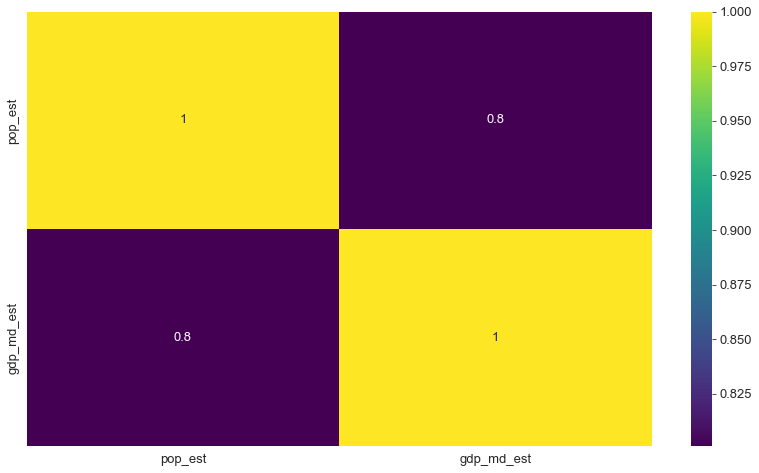

In [43]:
sns.heatmap(gdf.corr(),annot=True,cmap='viridis')
plt.show()

In [44]:
gdf.isnull().sum()

pop_est       0
continent     0
name          0
iso_a3        0
gdp_md_est    0
geometry      0
dtype: int64

In [45]:
gdf.duplicated().sum()

0

In [46]:
gdf['continent'].value_counts()

Africa                     51
Asia                       47
Europe                     39
North America              18
South America              13
Oceania                     7
Seven seas (open ocean)     1
Antarctica                  1
Name: continent, dtype: int64

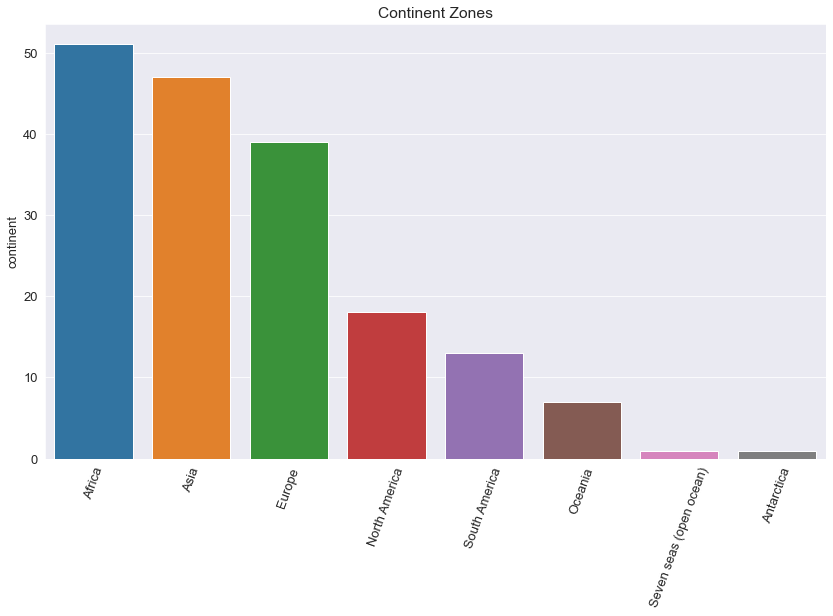

In [47]:

plt.title('Continent Zones')
plt.xticks(rotation=70)
sns.barplot(y=gdf['continent'].value_counts(),x=gdf['continent'].value_counts().index)
plt.show()

In [48]:
gdf.head()

,pop_est,continent,name,iso_a3,gdp_md_est,geometry
0,920938,Oceania,Fiji,FJI,8374.0,"MULTIPOLYGON (((180.00000 -16.06713, 180.00000..."
1,53950935,Africa,Tanzania,TZA,150600.0,"POLYGON ((33.90371 -0.95000, 34.07262 -1.05982..."
2,603253,Africa,W. Sahara,ESH,906.5,"POLYGON ((-8.66559 27.65643, -8.66512 27.58948..."
3,35623680,North America,Canada,CAN,1674000.0,"MULTIPOLYGON (((-122.84000 49.00000, -122.9742..."
4,326625791,North America,United States of America,USA,18560000.0,"MULTIPOLYGON (((-122.84000 49.00000, -120.0000..."


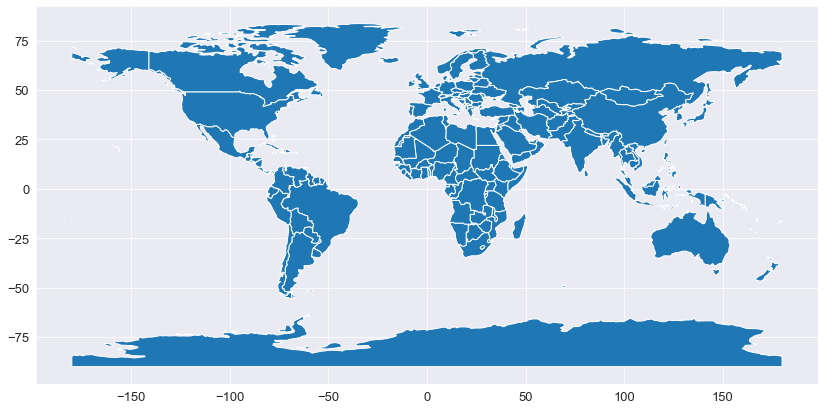

In [49]:
gdf.plot()
plt.show()

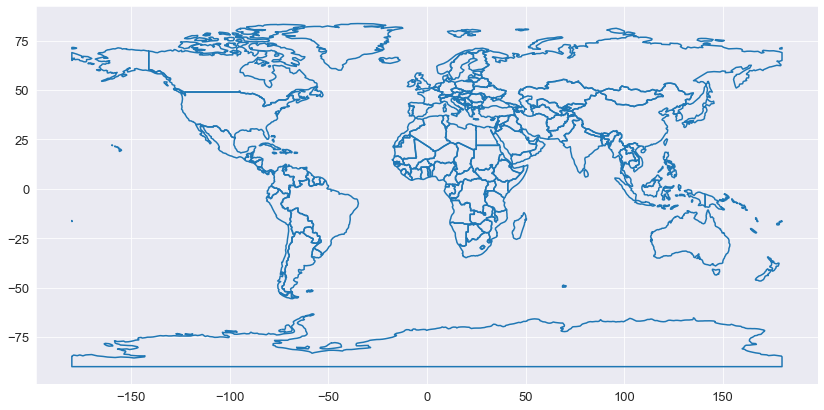

In [53]:
gdf.boundary.plot()
plt.show()

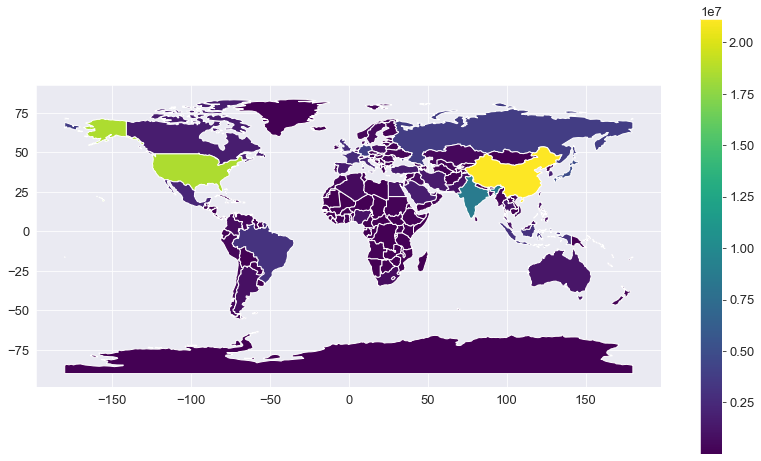

In [29]:
fig, ax = plt.subplots(1, 1)

gdf.plot(column='gdp_md_est',ax=ax,legend=True,cmap='viridis')
plt.show()

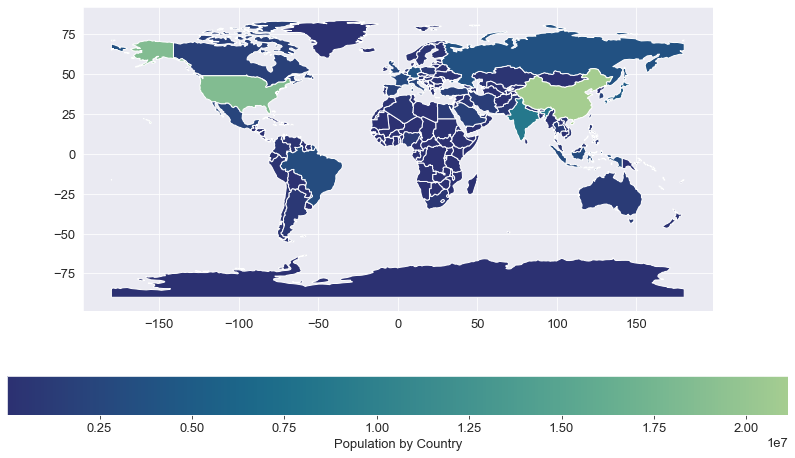

In [30]:
fig, ax = plt.subplots(1, 1)
gdf.plot(column='gdp_md_est',ax=ax,legend=True,cmap='crest_r',legend_kwds={'label':'Population by Country','orientation':'horizontal'})
plt.show()

In [79]:
gdf.explore()


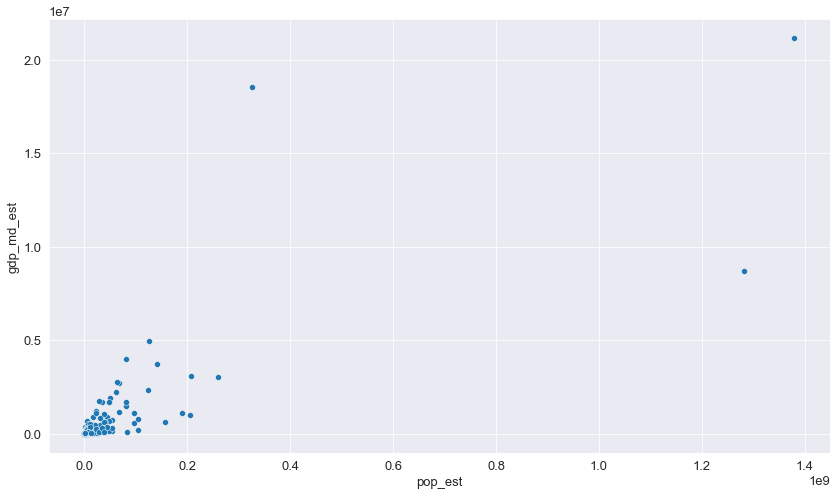

In [32]:
sns.scatterplot(x='pop_est',y='gdp_md_est',data=gdf)
plt.show()

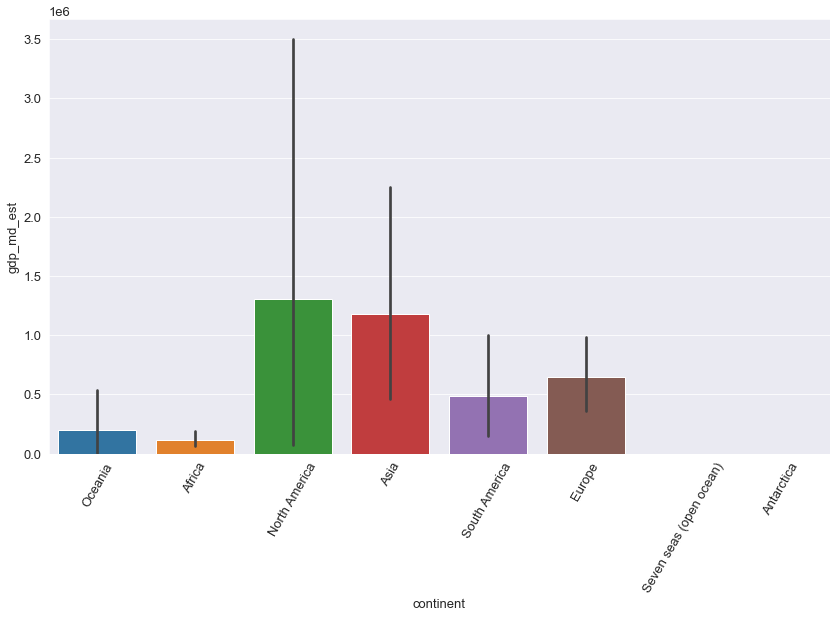

In [33]:
plt.xticks(rotation=60)
sns.barplot(x='continent',y='gdp_md_est',data=gdf)
plt.show()

In [11]:
data_path=pg.datasets.get_path("nybb")

In [12]:
raw_data=pg.read_file(data_path)

In [13]:
raw_data

,BoroCode,BoroName,Shape_Leng,Shape_Area,geometry
0,5,Staten Island,330470.010332,1.623820e+09,"MULTIPOLYGON (((970217.022 145643.332, 970227...."
1,4,Queens,896344.047763,3.045213e+09,"MULTIPOLYGON (((1029606.077 156073.814, 102957..."
2,3,Brooklyn,741080.523166,1.937479e+09,"MULTIPOLYGON (((1021176.479 151374.797, 102100..."
3,1,Manhattan,359299.096471,6.364715e+08,"MULTIPOLYGON (((981219.056 188655.316, 980940...."
4,2,Bronx,464392.991824,1.186925e+09,"MULTIPOLYGON (((1012821.806 229228.265, 101278..."


In [14]:
raw_data.describe()

,BoroCode,Shape_Leng,Shape_Area
count,5.000000,5.000000,5.000000e+00
mean,3.000000,558317.333911,1.685981e+09
std,1.581139,249002.452978,9.034868e+08
min,1.000000,330470.010332,6.364715e+08
25%,2.000000,359299.096471,1.186925e+09
50%,3.000000,464392.991824,1.623820e+09
75%,4.000000,741080.523166,1.937479e+09
max,5.000000,896344.047763,3.045213e+09


In [15]:
raw_data.corr()

,BoroCode,Shape_Leng,Shape_Area
BoroCode,1.000000,0.237672,0.670788
Shape_Leng,0.237672,1.000000,0.861590
Shape_Area,0.670788,0.861590,1.000000


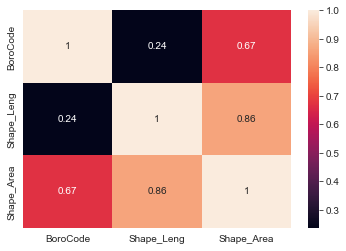

In [16]:
sns.heatmap(raw_data.corr(),annot=True)
plt.show()

In [17]:
raw_data.explore()

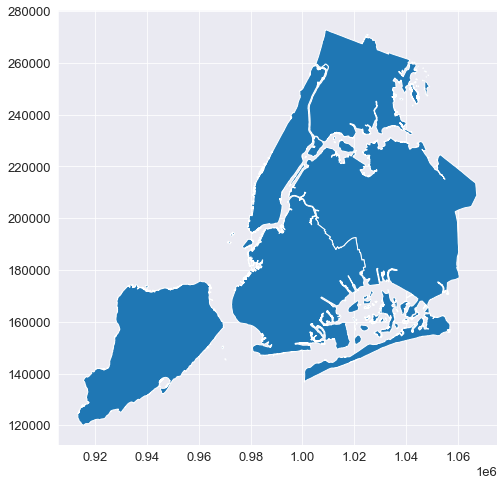

In [44]:
raw_data.plot()
plt.show()

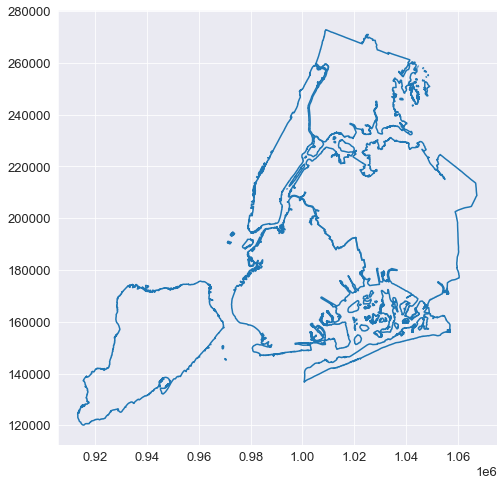

In [45]:
raw_data.boundary.plot()
plt.show()

In [19]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import geopandas as gpd
import contextily as cx
from shapely.geometry import Point
import geoplot.crs as gcrs
import geoplot as gplt
import pyproj

In [20]:
dist_df= gpd.read_file('E:/Shapefiles/districts.shp')
dist_df

,district,geometry
0,"Newry, Mourne and Down","POLYGON ((-5.82139 54.49408, -5.82128 54.49399..."
1,Mid Ulster,"POLYGON ((-6.53263 54.94913, -6.53253 54.94901..."
2,Mid and East Antrim,"POLYGON ((-5.96917 55.05284, -5.96909 55.05284..."
3,Lisburn and Castlereagh,"POLYGON ((-6.08760 54.62414, -6.08699 54.62394..."
4,"Armagh City, Banbridge and Craigavon","POLYGON ((-6.27820 54.54965, -6.27819 54.54960..."
5,Antrim and Newtownabbey,"POLYGON ((-6.16426 54.81062, -6.16405 54.81063..."
6,Ards and North Down,"MULTIPOLYGON (((-5.74192 54.67759, -5.74190 54..."
7,Fermanagh and Omagh,"POLYGON ((-6.99814 54.78009, -6.99806 54.78010..."
8,Derry City and Strabane,"POLYGON ((-7.25762 55.06648, -7.25759 55.06648..."
9,Causeway Coast and Glens,"MULTIPOLYGON (((-6.48405 55.25194, -6.48401 55..."


In [21]:
atm_df=gpd.read_file('E:/Shapefiles/atms.shp')
atm_df

,operator,geometry
0,Northern Bank,MULTIPOINT (-6.65841 54.50122)
1,None,MULTIPOINT (-6.22666 54.72956)
2,Bank of Ireland,MULTIPOINT (-6.22038 54.80819)
3,None,MULTIPOINT (-6.29858 54.43323)
4,None,MULTIPOINT (-6.21401 54.59141)
5,Danske Bank,MULTIPOINT (-6.27410 54.86649)
6,Bank of Ireland,MULTIPOINT (-6.27348 54.86643)
7,None,MULTIPOINT (-6.55924 54.95108)
8,Ulster Bank,MULTIPOINT (-6.15534 54.64155)
9,None,MULTIPOINT (-6.29950 54.84793)


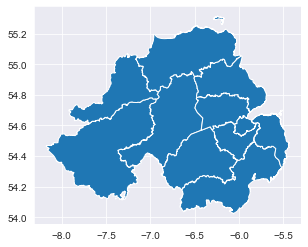

In [24]:
dist_df.plot()
plt.show()

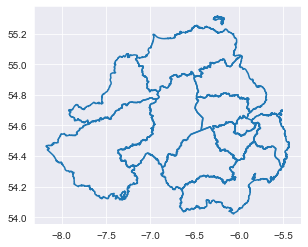

In [25]:
dist_df.boundary.plot()
plt.show()

In [26]:
dist_df.geometry.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [27]:
dist_df.explore()

In [28]:
dist_df['Area']=dist_df.area

In [29]:
dist_df.area

0     0.231567
1     0.271771
2     0.148379
3     0.070726
4     0.198376
5     0.101362
6     0.078567
7     0.416092
8     0.174482
9     0.278740
10    0.019125
dtype: float64

In [32]:
dist_df.drop(['area'],axis=1,inplace=True)

In [33]:
dist_df['Boundary']=dist_df.boundary

In [34]:
dist_df

,district,geometry,Boundary,Area
0,"Newry, Mourne and Down","POLYGON ((-5.82139 54.49408, -5.82128 54.49399...","LINESTRING (-5.82139 54.49408, -5.82128 54.493...",0.231567
1,Mid Ulster,"POLYGON ((-6.53263 54.94913, -6.53253 54.94901...","LINESTRING (-6.53263 54.94913, -6.53253 54.949...",0.271771
2,Mid and East Antrim,"POLYGON ((-5.96917 55.05284, -5.96909 55.05284...","LINESTRING (-5.96917 55.05284, -5.96909 55.052...",0.148379
3,Lisburn and Castlereagh,"POLYGON ((-6.08760 54.62414, -6.08699 54.62394...","LINESTRING (-6.08760 54.62414, -6.08699 54.623...",0.070726
4,"Armagh City, Banbridge and Craigavon","POLYGON ((-6.27820 54.54965, -6.27819 54.54960...","LINESTRING (-6.27820 54.54965, -6.27819 54.549...",0.198376
5,Antrim and Newtownabbey,"POLYGON ((-6.16426 54.81062, -6.16405 54.81063...","LINESTRING (-6.16426 54.81062, -6.16405 54.810...",0.101362
6,Ards and North Down,"MULTIPOLYGON (((-5.74192 54.67759, -5.74190 54...","MULTILINESTRING ((-5.74192 54.67759, -5.74190 ...",0.078567
7,Fermanagh and Omagh,"POLYGON ((-6.99814 54.78009, -6.99806 54.78010...","LINESTRING (-6.99814 54.78009, -6.99806 54.780...",0.416092
8,Derry City and Strabane,"POLYGON ((-7.25762 55.06648, -7.25759 55.06648...","LINESTRING (-7.25762 55.06648, -7.25759 55.066...",0.174482
9,Causeway Coast and Glens,"MULTIPOLYGON (((-6.48405 55.25194, -6.48401 55...","MULTILINESTRING ((-6.48405 55.25194, -6.48401 ...",0.278740


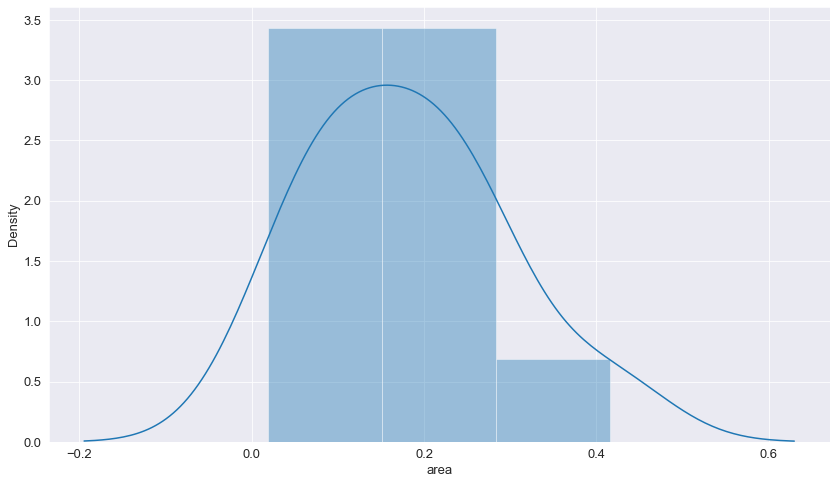

In [25]:
sns.distplot(dist_df['area'])
plt.show()

In [27]:
dist_df.centroid

0     POINT (-6.06785 54.23627)
1     POINT (-6.79188 54.62196)
2     POINT (-6.10242 54.87439)
3     POINT (-6.05347 54.50832)
4     POINT (-6.45745 54.36931)
5     POINT (-6.19869 54.70182)
6     POINT (-5.63026 54.53487)
7     POINT (-7.50382 54.44264)
8     POINT (-7.36043 54.82048)
9     POINT (-6.59177 55.06015)
10    POINT (-5.94382 54.59643)
dtype: geometry

In [35]:
dist_df['Centroid']=dist_df.centroid

In [30]:
gdf

,pop_est,continent,name,iso_a3,gdp_md_est,geometry
0,920938,Oceania,Fiji,FJI,8374.0,"MULTIPOLYGON (((180.00000 -16.06713, 180.00000..."
1,53950935,Africa,Tanzania,TZA,150600.0,"POLYGON ((33.90371 -0.95000, 34.07262 -1.05982..."
2,603253,Africa,W. Sahara,ESH,906.5,"POLYGON ((-8.66559 27.65643, -8.66512 27.58948..."
3,35623680,North America,Canada,CAN,1674000.0,"MULTIPOLYGON (((-122.84000 49.00000, -122.9742..."
4,326625791,North America,United States of America,USA,18560000.0,"MULTIPOLYGON (((-122.84000 49.00000, -120.0000..."
...,...,...,...,...,...,...
172,7111024,Europe,Serbia,SRB,101800.0,"POLYGON ((18.82982 45.90887, 18.82984 45.90888..."
173,642550,Europe,Montenegro,MNE,10610.0,"POLYGON ((20.07070 42.58863, 19.80161 42.50009..."
174,1895250,Europe,Kosovo,-99,18490.0,"POLYGON ((20.59025 41.85541, 20.52295 42.21787..."
175,1218208,North America,Trinidad and Tobago,TTO,43570.0,"POLYGON ((-61.68000 10.76000, -61.10500 10.890..."


In [49]:
type(gdf)

geopandas.geodataframe.GeoDataFrame

In [50]:
gdf

,pop_est,continent,name,iso_a3,gdp_md_est,geometry
0,920938,Oceania,Fiji,FJI,8374.0,"MULTIPOLYGON (((180.00000 -16.06713, 180.00000..."
1,53950935,Africa,Tanzania,TZA,150600.0,"POLYGON ((33.90371 -0.95000, 34.07262 -1.05982..."
2,603253,Africa,W. Sahara,ESH,906.5,"POLYGON ((-8.66559 27.65643, -8.66512 27.58948..."
3,35623680,North America,Canada,CAN,1674000.0,"MULTIPOLYGON (((-122.84000 49.00000, -122.9742..."
4,326625791,North America,United States of America,USA,18560000.0,"MULTIPOLYGON (((-122.84000 49.00000, -120.0000..."
...,...,...,...,...,...,...
172,7111024,Europe,Serbia,SRB,101800.0,"POLYGON ((18.82982 45.90887, 18.82984 45.90888..."
173,642550,Europe,Montenegro,MNE,10610.0,"POLYGON ((20.07070 42.58863, 19.80161 42.50009..."
174,1895250,Europe,Kosovo,-99,18490.0,"POLYGON ((20.59025 41.85541, 20.52295 42.21787..."
175,1218208,North America,Trinidad and Tobago,TTO,43570.0,"POLYGON ((-61.68000 10.76000, -61.10500 10.890..."


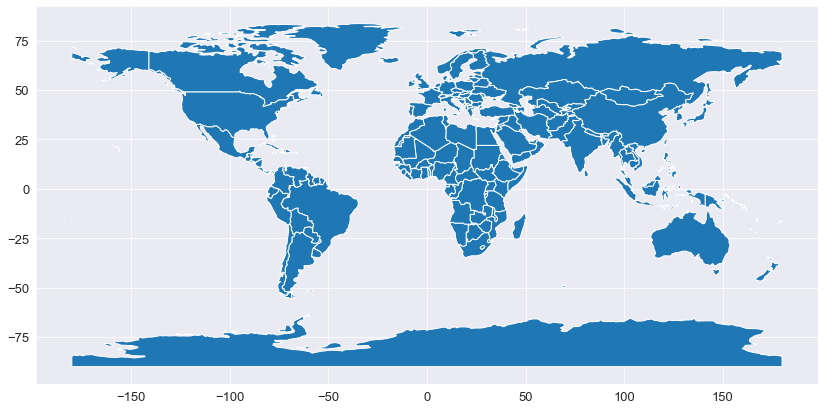

In [63]:
gdf.plot()
plt.show()

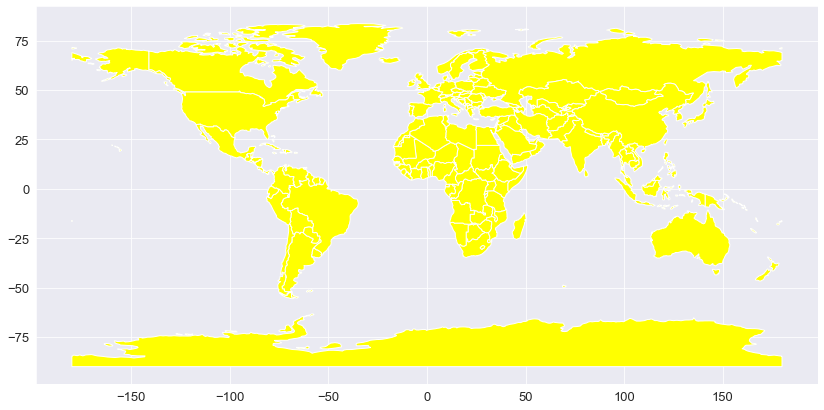

In [64]:
gdf.plot(color='yellow')
plt.show()

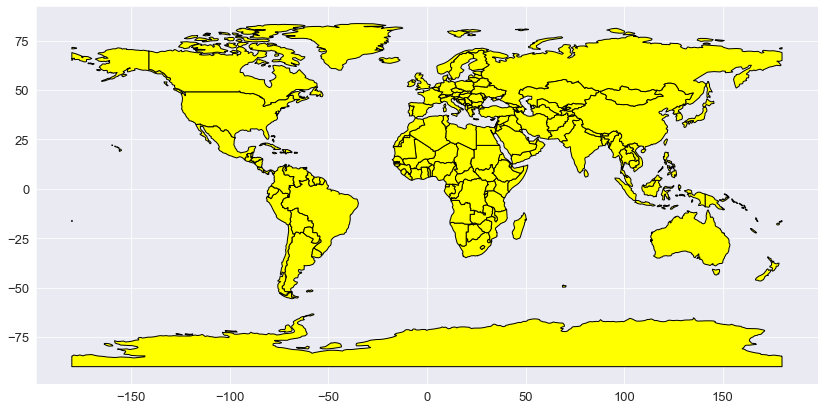

In [60]:
gdf.plot(color='yellow',edgecolor='black')
plt.show()

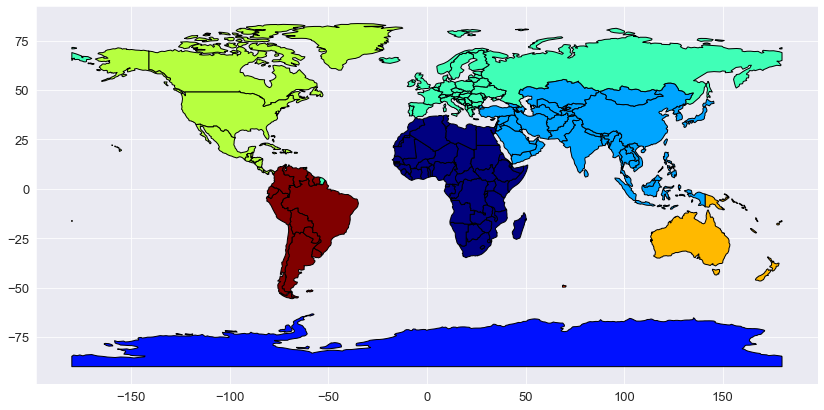

In [59]:
gdf.plot(cmap='jet',edgecolor='black',column='continent')
plt.show()

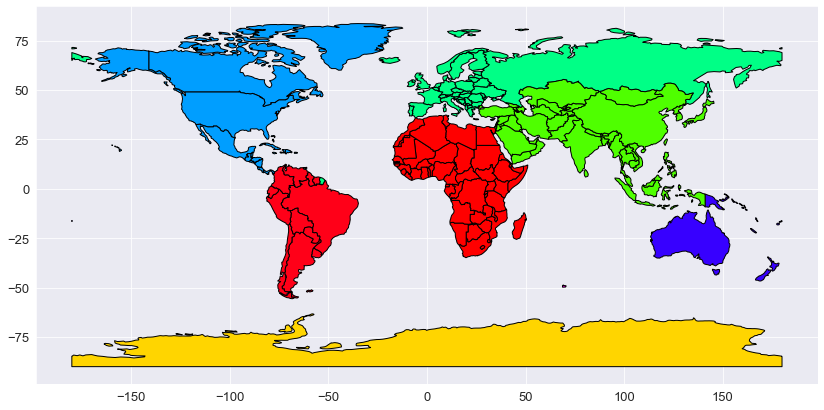

In [65]:
gdf.plot(cmap='hsv',edgecolor='black',column='continent')
plt.show()

In [69]:
area=gpd.read_file(r'area_of_interest.shp')

<AxesSubplot:>

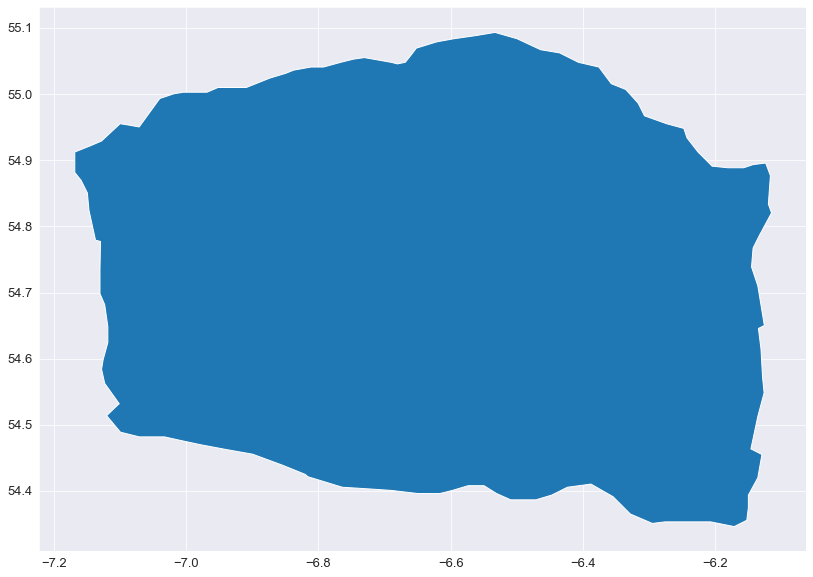

In [70]:
area.plot()

<AxesSubplot:>

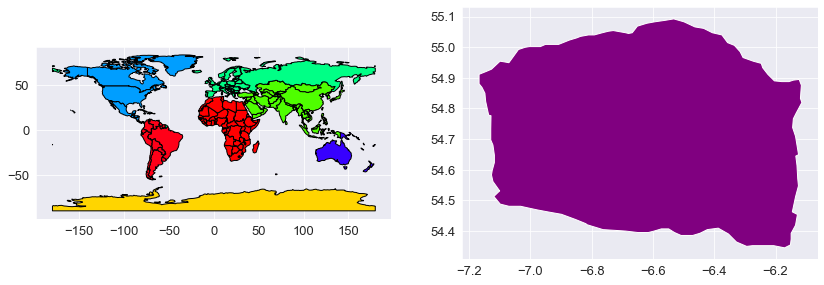

In [77]:
fig,(ax1,ax2)=plt.subplots(ncols=2,figsize=(14,8))
gdf.plot(ax=ax1,cmap='hsv',edgecolor='black',column='continent')
area.plot(ax=ax2,color='purple')

<AxesSubplot:>

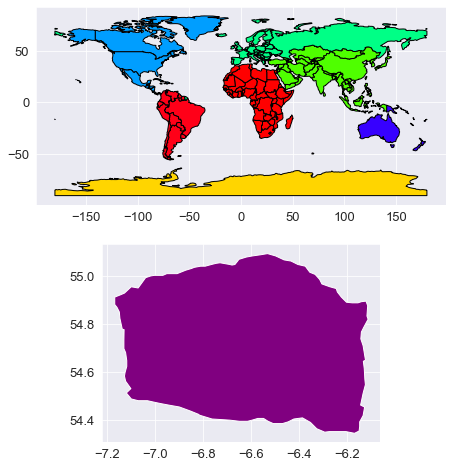

In [78]:
fig,(ax1,ax2)=plt.subplots(nrows=2,figsize=(14,8))
gdf.plot(ax=ax1,cmap='hsv',edgecolor='black',column='continent')
area.plot(ax=ax2,color='purple')

<AxesSubplot:>

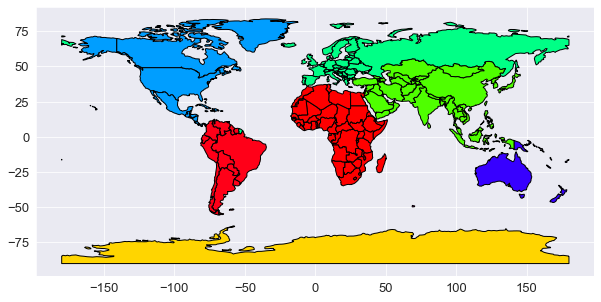

In [84]:
fig1,ax=plt.subplots(figsize=(10,8))
gdf.plot(ax=ax,cmap='hsv',edgecolor='black',column='continent')
area.plot(ax=ax,color='pink')

In [7]:
gdf

,pop_est,continent,name,iso_a3,gdp_md_est,geometry
0,920938,Oceania,Fiji,FJI,8374.0,"MULTIPOLYGON (((180.00000 -16.06713, 180.00000..."
1,53950935,Africa,Tanzania,TZA,150600.0,"POLYGON ((33.90371 -0.95000, 34.07262 -1.05982..."
2,603253,Africa,W. Sahara,ESH,906.5,"POLYGON ((-8.66559 27.65643, -8.66512 27.58948..."
3,35623680,North America,Canada,CAN,1674000.0,"MULTIPOLYGON (((-122.84000 49.00000, -122.9742..."
4,326625791,North America,United States of America,USA,18560000.0,"MULTIPOLYGON (((-122.84000 49.00000, -120.0000..."
...,...,...,...,...,...,...
172,7111024,Europe,Serbia,SRB,101800.0,"POLYGON ((18.82982 45.90887, 18.82984 45.90888..."
173,642550,Europe,Montenegro,MNE,10610.0,"POLYGON ((20.07070 42.58863, 19.80161 42.50009..."
174,1895250,Europe,Kosovo,-99,18490.0,"POLYGON ((20.59025 41.85541, 20.52295 42.21787..."
175,1218208,North America,Trinidad and Tobago,TTO,43570.0,"POLYGON ((-61.68000 10.76000, -61.10500 10.890..."


# BUFFER_ANALYSIS

In [8]:
continent_centroid=gdf.geometry.centroid

In [9]:
continent_centroid

0      POINT (163.85316 -17.31631)
1        POINT (34.75299 -6.25773)
2       POINT (-12.13783 24.29117)
3       POINT (-98.14238 61.46908)
4      POINT (-112.59944 45.70563)
                  ...             
172      POINT (20.81965 44.23304)
173      POINT (19.28618 42.78904)
174      POINT (20.89536 42.57937)
175     POINT (-61.33037 10.42824)
176       POINT (30.19862 7.29289)
Length: 177, dtype: geometry

<AxesSubplot:>

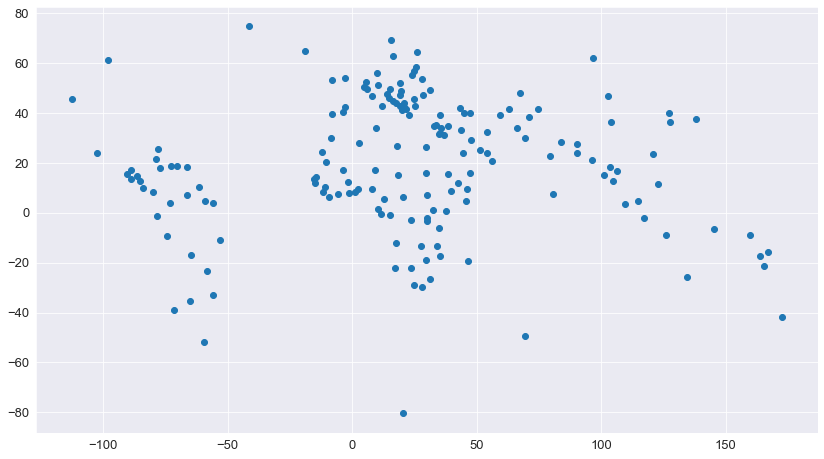

In [12]:
continent_centroid.plot()

<AxesSubplot:>

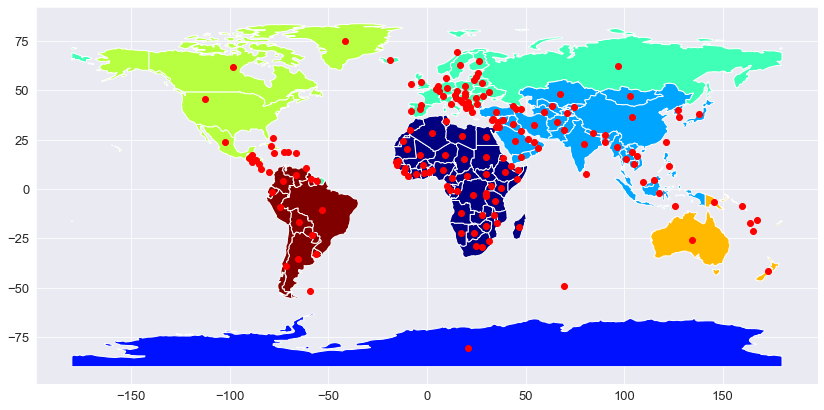

In [14]:
fig,ax=plt.subplots(figsize=(14,10))
gdf.plot(ax=ax,cmap='jet',column='continent')
continent_centroid.plot(ax=ax,color='red')